In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error, accuracy_score, f1_score, confusion_matrix, roc_auc_score, recall_score, classification_report
from sklearn import preprocessing
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split, learning_curve, KFold, cross_val_score, cross_val_predict
from sklearn.tree import DecisionTreeClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn import linear_model

In [2]:
student_data = pd.read_csv('dataset.csv', header = 0)
student_data.head()

,Student Number2,Ending YRTR,Start YRTR,Ending Term,Ending Term Type,Admission Category,Male,Female,Gender,Student of Color Value,...,Transfer Time in Years,Transfer Time Category,Transfer Instituion Type,Transfer Instituion Name,Transfer Instituion State,Transfer Instituion In/Out State,Transfer Instituion Public/Private,Transfer ZIP,Transfer Region,Transfer = Home Region Value
0,0,0,8,0,0,1,0,1,0,0,...,1,0,1,391,21,0,1,245,5,0
1,1,6,34,3,0,0,0,1,0,0,...,1,0,1,391,21,0,1,245,5,0
2,2,0,25,0,0,0,1,0,1,0,...,1,0,1,391,21,0,1,245,5,0
3,3,1,26,5,1,0,0,1,0,0,...,1,0,1,391,21,0,1,245,5,0
4,4,1,4,5,1,0,0,1,0,0,...,1,0,1,391,21,0,1,245,5,0


In [3]:
student_data.head()

,Student Number2,Ending YRTR,Start YRTR,Ending Term,Ending Term Type,Admission Category,Male,Female,Gender,Student of Color Value,...,Transfer Time in Years,Transfer Time Category,Transfer Instituion Type,Transfer Instituion Name,Transfer Instituion State,Transfer Instituion In/Out State,Transfer Instituion Public/Private,Transfer ZIP,Transfer Region,Transfer = Home Region Value
0,0,0,8,0,0,1,0,1,0,0,...,1,0,1,391,21,0,1,245,5,0
1,1,6,34,3,0,0,0,1,0,0,...,1,0,1,391,21,0,1,245,5,0
2,2,0,25,0,0,0,1,0,1,0,...,1,0,1,391,21,0,1,245,5,0
3,3,1,26,5,1,0,0,1,0,0,...,1,0,1,391,21,0,1,245,5,0
4,4,1,4,5,1,0,0,1,0,0,...,1,0,1,391,21,0,1,245,5,0


In [4]:
print(student_data.shape) 
student_data.dtypes

(21014, 112)


Student Number2                       int64
Ending YRTR                           int64
Start YRTR                            int64
Ending Term                           int64
Ending Term Type                      int64
                                      ...  
Transfer Instituion In/Out State      int64
Transfer Instituion Public/Private    int64
Transfer ZIP                          int64
Transfer Region                       int64
Transfer = Home Region Value          int64
Length: 112, dtype: object

In [5]:
target = student_data["Student Outcome"]

In [6]:
target.head()

0    0
1    0
2    0
3    0
4    1
Name: Student Outcome, dtype: int64

In [7]:
corr = student_data.corr(method='pearson').abs() 
print(corr)

                                    Student Number2  Ending YRTR  Start YRTR  \
Student Number2                            1.000000     0.561451    0.852468   
Ending YRTR                                0.561451     1.000000    0.561209   
Start YRTR                                 0.852468     0.561209    1.000000   
Ending Term                                0.323742     0.637992    0.328152   
Ending Term Type                           0.040181     0.150363    0.046004   
...                                             ...          ...         ...   
Transfer Instituion In/Out State           0.195148     0.025712    0.173453   
Transfer Instituion Public/Private         0.116781     0.002932    0.113484   
Transfer ZIP                               0.046341     0.002231    0.036390   
Transfer Region                            0.299153     0.015072    0.279722   
Transfer = Home Region Value               0.283298     0.002774    0.238203   

                                    End

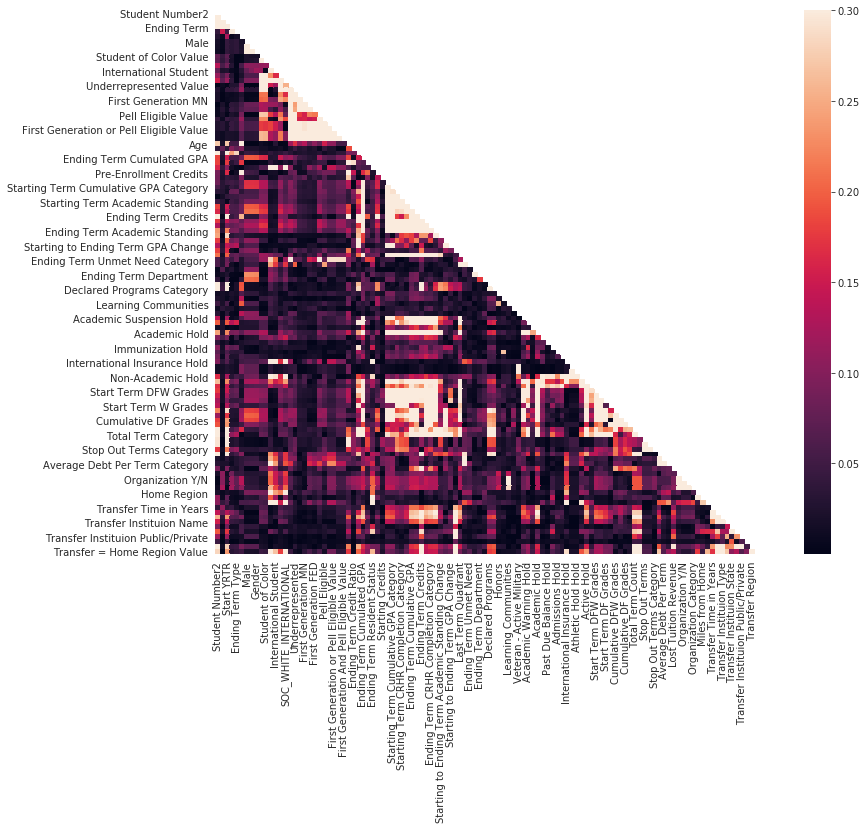

In [8]:
mask = np.zeros_like(corr)
mask[np.triu_indices_from(mask)] = True 
with sns.axes_style("white"):
    f, ax = plt.subplots(figsize=(16, 10))
    ax = sns.heatmap(corr, mask=mask, vmax=.3, square=True)

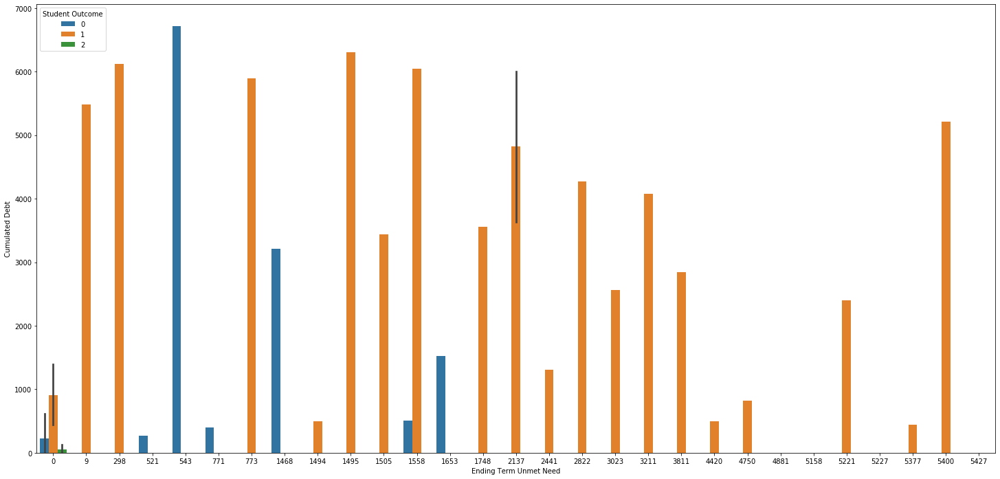

In [9]:
plt.figure(figsize=(25,12))
sns.barplot(data=student_data.head(100), x= "Ending Term Unmet Need", y="Cumulated Debt", hue="Student Outcome")

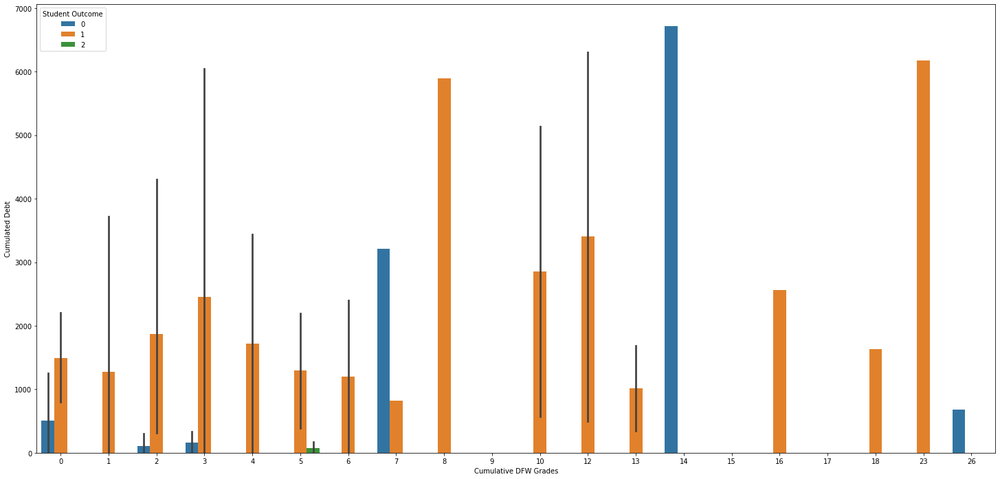

In [10]:
plt.figure(figsize=(25,12))
sns.barplot(data=student_data.head(100), x= "Cumulative DFW Grades", y="Cumulated Debt", hue="Student Outcome")

In [11]:
del student_data["Student Outcome"]
del student_data["Transfer Instituion State"]
del student_data["Transfer Instituion Name"]
del student_data["Transfer Region"]
del student_data['Transfer = Home Region Value']
del student_data["Transfer ZIP"]
del student_data["Student Number2"]
del student_data["Lost Tuition Revenue"]
del student_data["Miles from Home"]
del student_data["Ending Term Cumulated GPA"]
del student_data["Ending Term Cumulative GPA"]
del student_data["Transfer Time in Years"]
reg = linear_model.LassoCV()
reg.fit(student_data, target)
print("Best alpha using built-in LassoCV: %f" % reg.alpha_)
print("Best score using built-in LassoCV: %f" %reg.score(student_data,target)) 
coef = pd.Series(reg.coef_, index = student_data.columns)
print("Lasso picked " + str(sum(coef != 0)) + " variables and eliminated the other " + str(sum(coef == 0)) + " variables")

Best alpha using built-in LassoCV: 0.158401
Best score using built-in LassoCV: 0.112725
Lasso picked 10 variables and eliminated the other 90 variables


Age                             -0.010149
Starting Term CRHR Completion   -0.001535
Ending Term Credits             -0.000777
Cumulated Debt                  -0.000056
Pre-Enrollment Credits          -0.000053
Ending Term Unmet Need           0.000008
Average Debt Per Term            0.000044
Ending Term Department           0.000180
Starting Term Cumulative GPA     0.000550
Ending Term CRHR Completion      0.006087
dtype: float64


Text(0.5, 1.0, 'Feature importance using Lasso Model')

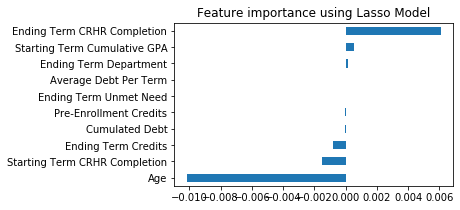

In [12]:
imp_coef = coef.sort_values() 
plt.rcParams['figure.figsize'] = (5.0, 3.0)

relevant_features = imp_coef[imp_coef!=0] 
print(relevant_features) 
relevant_features.plot(kind = "barh") 
plt.title("Feature importance using Lasso Model")
 

In [13]:
data = student_data[[ 'Age',
                     "Starting Term CRHR Completion", 
                     "Pre-Enrollment Credits", 
                     "Ending Term Credits",
                     "Cumulated Debt",
                     'Ending Term Department', 
                     "Ending Term Unmet Need", 
                     "Average Debt Per Term", 
                     "Starting Term Cumulative GPA", 
                     "Ending Term CRHR Completion"
                     ]] 
data.head()

,Age,Starting Term CRHR Completion,Pre-Enrollment Credits,Ending Term Credits,Cumulated Debt,Ending Term Department,Ending Term Unmet Need,Average Debt Per Term,Starting Term Cumulative GPA,Ending Term CRHR Completion
0,45,99,15,55,0,21,0,0,379,84
1,53,99,0,13,0,49,0,0,181,97
2,33,93,0,548,0,55,0,0,325,91
3,35,99,0,96,0,18,0,0,379,97
4,31,99,0,252,1241,43,0,271,260,97


In [14]:
data.corr(method="pearson")

,Age,Starting Term CRHR Completion,Pre-Enrollment Credits,Ending Term Credits,Cumulated Debt,Ending Term Department,Ending Term Unmet Need,Average Debt Per Term,Starting Term Cumulative GPA,Ending Term CRHR Completion
Age,1.000000,-0.041120,0.369302,0.408657,0.049916,0.045945,-0.097780,-0.082673,0.139361,0.075948
Starting Term CRHR Completion,-0.041120,1.000000,0.081141,0.178570,0.096770,-0.023734,0.006079,0.026575,0.377786,0.667071
Pre-Enrollment Credits,0.369302,0.081141,1.000000,0.377343,-0.116084,0.048413,0.007623,-0.025935,0.157378,0.121404
Ending Term Credits,0.408657,0.178570,0.377343,1.000000,0.318665,-0.025159,-0.061321,-0.077080,0.346839,0.466565
Cumulated Debt,0.049916,0.096770,-0.116084,0.318665,1.000000,-0.019488,0.052788,0.725513,0.039784,0.132524
Ending Term Department,0.045945,-0.023734,0.048413,-0.025159,-0.019488,1.000000,0.029720,0.023081,0.060338,0.020001
Ending Term Unmet Need,-0.097780,0.006079,0.007623,-0.061321,0.052788,0.029720,1.000000,0.003498,0.012327,-0.017755
Average Debt Per Term,-0.082673,0.026575,-0.025935,-0.077080,0.725513,0.023081,0.003498,1.000000,-0.097976,-0.024434
Starting Term Cumulative GPA,0.139361,0.377786,0.157378,0.346839,0.039784,0.060338,0.012327,-0.097976,1.000000,0.470386
Ending Term CRHR Completion,0.075948,0.667071,0.121404,0.466565,0.132524,0.020001,-0.017755,-0.024434,0.470386,1.000000


In [15]:
data.corr(method="spearman")

,Age,Starting Term CRHR Completion,Pre-Enrollment Credits,Ending Term Credits,Cumulated Debt,Ending Term Department,Ending Term Unmet Need,Average Debt Per Term,Starting Term Cumulative GPA,Ending Term CRHR Completion
Age,1.000000,-0.059871,0.300978,0.665096,0.171029,-0.043123,-0.129674,-0.069822,0.145922,0.054467
Starting Term CRHR Completion,-0.059871,1.000000,0.038337,0.130549,0.047567,-0.012523,0.015054,-0.008154,0.289793,0.520685
Pre-Enrollment Credits,0.300978,0.038337,1.000000,0.303864,-0.054486,0.016617,0.041302,0.005142,0.181582,0.171830
Ending Term Credits,0.665096,0.130549,0.303864,1.000000,0.267024,-0.041319,-0.071729,-0.043119,0.312746,0.388131
Cumulated Debt,0.171029,0.047567,-0.054486,0.267024,1.000000,-0.006115,0.196521,0.836440,-0.048828,-0.014795
Ending Term Department,-0.043123,-0.012523,0.016617,-0.041319,-0.006115,1.000000,0.033834,0.023458,0.070011,0.057145
Ending Term Unmet Need,-0.129674,0.015054,0.041302,-0.071729,0.196521,0.033834,1.000000,0.168422,-0.002779,0.010769
Average Debt Per Term,-0.069822,-0.008154,0.005142,-0.043119,0.836440,0.023458,0.168422,1.000000,-0.128024,-0.079120
Starting Term Cumulative GPA,0.145922,0.289793,0.181582,0.312746,-0.048828,0.070011,-0.002779,-0.128024,1.000000,0.486721
Ending Term CRHR Completion,0.054467,0.520685,0.171830,0.388131,-0.014795,0.057145,0.010769,-0.079120,0.486721,1.000000


In [16]:
#Logistic Regression
from sklearn.model_selection import train_test_split 
X_train, X_test, y_train, y_test = train_test_split(data, target, test_size=0.30, random_state=101)
X_test.shape

(6305, 10)

In [17]:
from sklearn.linear_model import LogisticRegression#create an instance and fit the model
logmodel = LogisticRegression()
logmodel.fit(X_train, y_train)

/Users/ilmasheriff/opt/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_logistic.py:940: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG)


LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
                   intercept_scaling=1, l1_ratio=None, max_iter=100,
                   multi_class='auto', n_jobs=None, penalty='l2',
                   random_state=None, solver='lbfgs', tol=0.0001, verbose=0,
                   warm_start=False)

In [18]:
#predictions
predictions = logmodel.predict(X_test)

In [19]:
print(classification_report(y_test,predictions))

              precision    recall  f1-score   support

           0       0.57      0.04      0.08      1040
           1       0.87      0.98      0.93      3643
           2       0.65      0.86      0.74      1622

    accuracy                           0.80      6305
   macro avg       0.70      0.63      0.58      6305
weighted avg       0.77      0.80      0.74      6305



In [20]:
def multiclass_roc_auc_score(y_test, y_pred, average="macro"): 
    lb = preprocessing.LabelBinarizer()
    lb.fit(y_test)
    y_test = lb.transform(y_test)
    y_pred = lb.transform(y_pred)
    return roc_auc_score(y_test, y_pred, average=average)

In [21]:
print("Accuracy", accuracy_score(y_test, predictions)) 
print("ROC", multiclass_roc_auc_score(y_test, predictions))

Accuracy 0.7963521015067406
ROC 0.7544662303561696


In [22]:
import itertools
def plot_confusion_matrix(cm, classes,normalize=False, cmap=plt.cm.Oranges):
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis] 
        print("Normalized confusion matrix")
        print('Confusion matrix, without normalization')
    else: 
        print(cm)
        
    # Plot the confusion matrix
    plt.figure(figsize = (10, 6))
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    
    plt.colorbar(aspect=4)
    tick_marks = np.arange(len(classes)) 
    plt.xticks(tick_marks, classes, rotation=45, size = 14) 
    plt.yticks(tick_marks, classes, size = 14)

    fmt = '.2f' if normalize else 'd' 
    thresh = cm.max() / 2.
        
    # Labeling the plot
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])): 
        plt.text(j, i, format(cm[i, j], fmt), fontsize = 20,
        horizontalalignment="center",
        color="white" if cm[i, j] > thresh else "black")
        plt.grid(None)
        plt.tight_layout()
        plt.ylabel('True label', size = 18) 
        plt.xlabel('Predicted label', size = 18)

[[  42  313  685]
 [   4 3586   53]
 [  28  201 1393]]


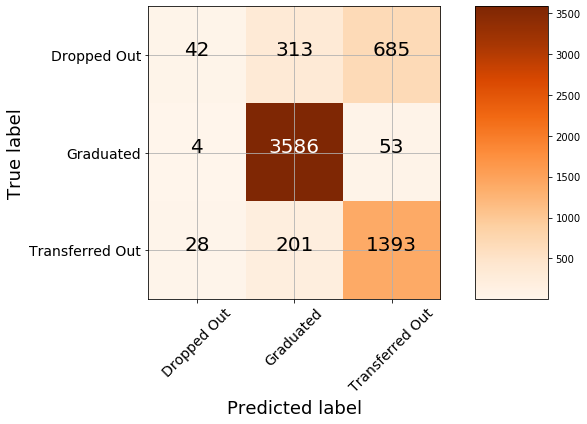

In [23]:
# Confusion matrix
cm = confusion_matrix(y_test, predictions)
plot_confusion_matrix(cm, classes = ["Dropped Out", "Graduated","Transferred Out" ])

In [24]:
clf = DecisionTreeClassifier() 

# Train Decision Tree Classifer
clf = clf.fit(X_train,y_train)

#Predict the response for test dataset
y_pred = clf.predict(X_test)

In [25]:
print("Accuracy:",accuracy_score(y_test, y_pred))
print("ROC", multiclass_roc_auc_score(y_test, y_pred))

Accuracy: 0.7682791435368755
ROC 0.7749306754832707


In [26]:
print(classification_report(y_test,y_pred))

              precision    recall  f1-score   support

           0       0.40      0.42      0.41      1040
           1       0.93      0.92      0.92      3643
           2       0.66      0.65      0.65      1622

    accuracy                           0.77      6305
   macro avg       0.66      0.66      0.66      6305
weighted avg       0.77      0.77      0.77      6305



In [27]:
from sklearn.tree import export_graphviz 
from sklearn.externals.six import StringIO 
from IPython.display import Image
import pydotplus

dot_data = StringIO() 
export_graphviz(clf, out_file=dot_data, 
                filled=True, 
                rounded=True,
                special_characters=True,feature_names = data.columns) 
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())
Image(graph.create_png())

/Users/ilmasheriff/opt/anaconda3/lib/python3.7/site-packages/sklearn/externals/six.py:31: FutureWarning: The module is deprecated in version 0.21 and will be removed in version 0.23 since we've dropped support for Python 2.7. Please rely on the official version of six (https://pypi.org/project/six/).
  "(https://pypi.org/project/six/).", FutureWarning)


In [28]:
pip install pydotplus

Note: you may need to restart the kernel to use updated packages.


In [29]:
clf = DecisionTreeClassifier(criterion="entropy", max_depth=3) # Train Decision Tree Classifer
clf = clf.fit(X_train,y_train)
#Predict the response for test dataset
y_prediction = clf.predict(X_test)

In [30]:
print("Accuracy:",accuracy_score(y_test, y_prediction))
print("ROC", multiclass_roc_auc_score(y_test, y_prediction))

Accuracy: 0.8139571768437748
ROC 0.7938323027769213


In [31]:
print(classification_report(y_test,y_prediction))

              precision    recall  f1-score   support

           0       0.50      0.27      0.35      1040
           1       0.93      0.97      0.95      3643
           2       0.68      0.81      0.74      1622

    accuracy                           0.81      6305
   macro avg       0.70      0.68      0.68      6305
weighted avg       0.79      0.81      0.80      6305



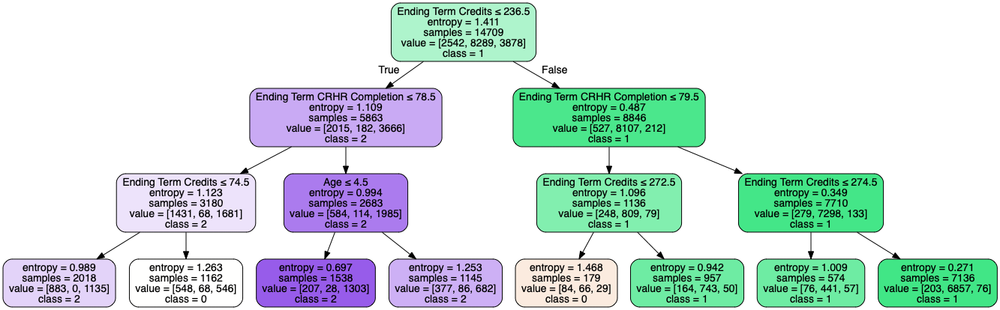

In [33]:
dot_data = StringIO() 
export_graphviz(clf, out_file=dot_data,
                filled=True,
                rounded=True,
                special_characters=True,
                feature_names = data.columns,class_names=['0','1','2'])
graph = pydotplus.graph_from_dot_data(dot_data.getvalue()) 
Image(graph.create_png())

[[ 279  183  578]
 [  56 3538   49]
 [ 223   84 1315]]


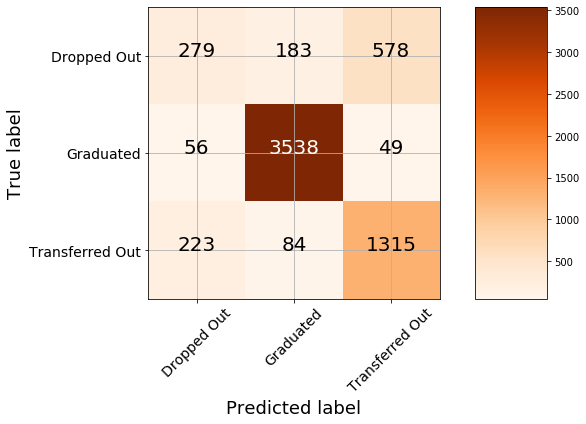

In [34]:
cm = confusion_matrix(y_test, y_prediction)
plot_confusion_matrix(cm, classes = ["Dropped Out", "Graduated","Transferred Out" ])

In [35]:
from sklearn.ensemble import RandomForestClassifier 

model = RandomForestClassifier(n_estimators=1000)
model.fit(X_train, y_train)
y_model = model.predict(X_test)

In [36]:
print("Accuracy", accuracy_score (y_test, y_model)) 
print("ROC", multiclass_roc_auc_score(y_test, y_model))

Accuracy 0.8274385408406026
ROC 0.8116417556495256


[[ 403  180  457]
 [  31 3565   47]
 [ 296   77 1249]]


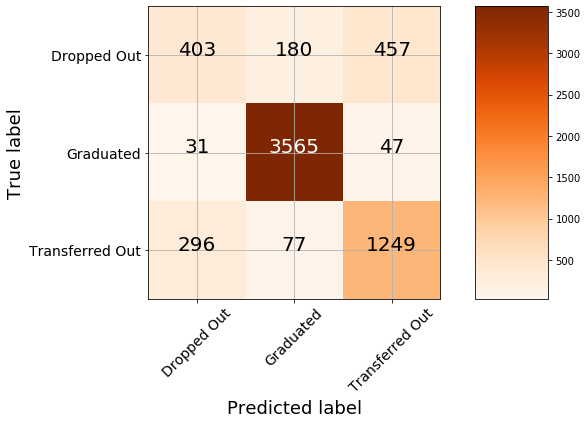

In [37]:
# Confusion matrix
cm = confusion_matrix(y_test, y_model)
plot_confusion_matrix(cm, classes = ["Dropped Out", "Graduated","Transferred Out" ])

In [38]:
print(classification_report(y_test,y_model))

              precision    recall  f1-score   support

           0       0.55      0.39      0.46      1040
           1       0.93      0.98      0.96      3643
           2       0.71      0.77      0.74      1622

    accuracy                           0.83      6305
   macro avg       0.73      0.71      0.72      6305
weighted avg       0.81      0.83      0.82      6305



In [39]:
from sklearn.naive_bayes import GaussianNB 
model = GaussianNB() 
model.fit(X_train, y_train) 
y_p = model.predict(X_test) 

In [40]:
print("ROC", multiclass_roc_auc_score(y_test, y_p)) 
print("Accuracy", accuracy_score (y_test, y_p))

ROC 0.7733693176030481
Accuracy 0.7914353687549563


[[ 251  231  558]
 [ 139 3459   45]
 [ 165  177 1280]]


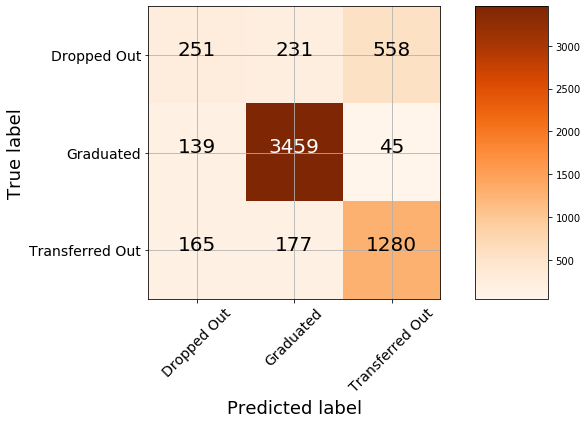

In [41]:
# Confusion matrix
cm = confusion_matrix(y_test, y_p)
plot_confusion_matrix(cm, classes = ["Dropped Out", "Graduated","Transferred Out" ])

In [42]:
print(classification_report(y_test,y_p))

              precision    recall  f1-score   support

           0       0.45      0.24      0.31      1040
           1       0.89      0.95      0.92      3643
           2       0.68      0.79      0.73      1622

    accuracy                           0.79      6305
   macro avg       0.68      0.66      0.66      6305
weighted avg       0.77      0.79      0.77      6305

